# Exploration du fichier des ventes consolidé

## Import nécessaires

In [1]:
import os
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib

Using matplotlib backend: module://matplotlib_inline.backend_inline


## Infos sur le fichier

In [2]:
folder_path = '../data/raw/Sales'
output_file = os.path.join(folder_path, 'merged_sales_data.csv')

chunksize = 100000  # Number of rows per chunk
chunks = pd.read_csv(output_file, sep=';', chunksize=chunksize, index_col=None, low_memory=False)

# Process chunks
df_sales = pd.concat(chunk for chunk in chunks)

df_sales.head()

,idannonce,type_annonceur,typedebien,typedetransaction,etage,surface,surface_terrain,nb_pieces,prix_bien,prix_maison,...,UU2010,REG,DEP,loyer_m2_median_n6,nb_log_n6,taux_rendement_n6,loyer_m2_median_n7,nb_log_n7,taux_rendement_n7,prix_m2_vente
0,entities-1037638-4560933,pr,m,v,0,79,470.0,4,241000,NaN,...,1501,84,1,9.81,3.0,0.039,10.42,9.0,0.041,3050.63
1,immo-facile-57743459,pr,a,v,0,65,650.0,2,136000,NaN,...,1501,84,1,10.65,3.0,0.061,10.50,11.0,0.060,2092.31
2,entities-1037666-4560741,pr,m,v,0,114,450.0,5,260900,NaN,...,1401,84,1,11.34,2.0,0.059,11.34,2.0,0.059,2288.60
3,immo-facile-57762298,pr,m,v,0,148,1500.0,7,286000,NaN,...,1501,84,1,NaN,NaN,NaN,7.27,2.0,0.045,1932.43
4,immo-facile-57762759,pr,m,v,0,213,2251.0,8,435000,NaN,...,1501,84,1,NaN,NaN,NaN,NaN,NaN,NaN,2042.25


## Valeurs manquantes :

In [5]:
missing_data_percentage_sales = df_sales.isna().sum()*100/len(df_sales)

missing_value_percentage_sales = pd.DataFrame({'column_name': df_sales.columns,
                                         'percent_missing': missing_data_percentage_sales,
                                         'dtypes':df_sales.dtypes}
                                         ).sort_values(by='percent_missing', ascending=False)

# Resetting the index to start from 1 for better readability
# and to match the original DataFrame's index
missing_value_percentage_sales.index = range(1, len(missing_value_percentage_sales) + 1)

display(missing_value_percentage_sales)

,column_name,percent_missing,dtypes
1,parking,99.761121,object
2,videophone,99.004907,object
3,prix_terrain,98.683484,float64
4,prix_maison,98.674711,float64
5,surface_balcon,97.638701,float64
6,nb_terraces,80.617557,float64
7,charges_copro,72.694995,float64
8,porte_digicode,72.539288,object
9,nb_logements_copro,72.334361,float64
10,ascenseur,70.936387,object


# Visualisation des NAN

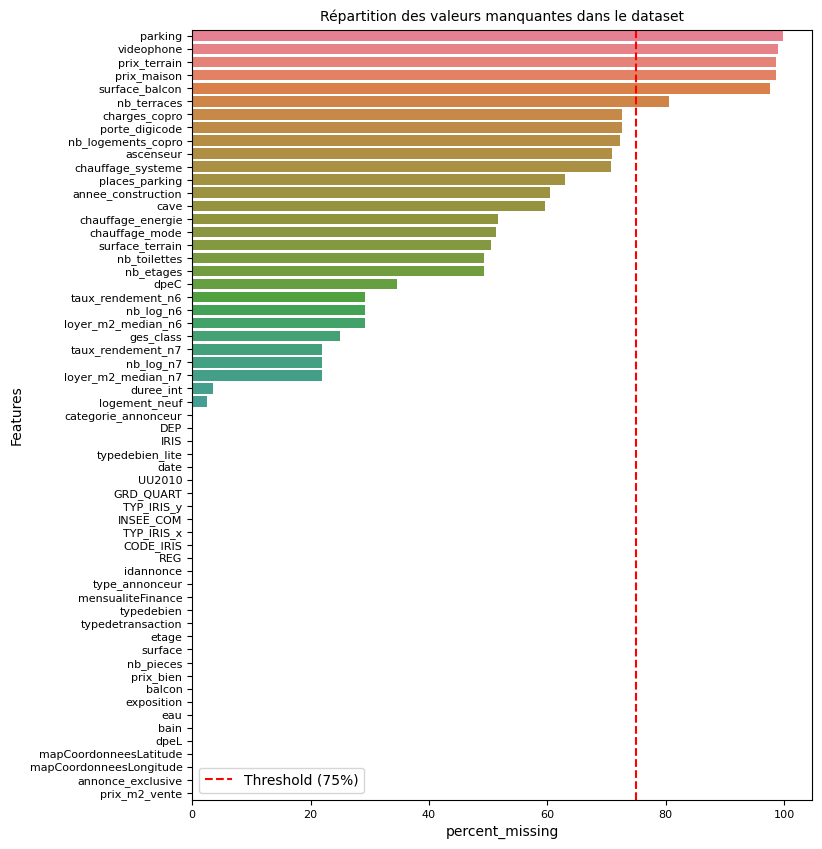

In [6]:
plt.figure(figsize=(8, 10))

sns.barplot(
    y=missing_value_percentage_sales.column_name,
    x=missing_value_percentage_sales.percent_missing,
    hue=missing_value_percentage_sales.column_name,
    order=missing_value_percentage_sales.column_name
)

# Add a vertical line at x=50 (adjust as needed)
plt.axvline(x=75, color='red', linestyle='--', label='Threshold (75%)')

plt.title('Répartition des valeurs manquantes dans le dataset', fontsize=10)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.ylabel('Features')
plt.legend()

plt.show()



### Nom des variables dont le pourcentage de valeurs manquantes est inférieur à 75 %

> Dans notre dataset, on constate que la grande diversité des variables. Cette grande diversité nous permet de faire le choix d'éliminer certaines variables qui représentent peu d'enjeux dans la prédiction de notre modèle, par exemple la surface du balcon. D'autres variables sont redondants quant ils sont renseignés car on connait le prix total du bien de toute manière. Arbitrairement, le seuil de valeurs manquantes que nous choisirons sera de 75 % de valeurs manquantes dans la variable.

In [7]:
missing_values = df_sales.isnull().mean()

variables_to_keep = missing_values[missing_values <= 0.75].index
print(variables_to_keep)

Index(['idannonce', 'type_annonceur', 'typedebien', 'typedetransaction',
       'etage', 'surface', 'surface_terrain', 'nb_pieces', 'prix_bien',
       'mensualiteFinance', 'balcon', 'eau', 'bain', 'dpeL', 'dpeC',
       'mapCoordonneesLatitude', 'mapCoordonneesLongitude',
       'annonce_exclusive', 'nb_etages', 'places_parking', 'cave',
       'exposition', 'ges_class', 'annee_construction', 'nb_toilettes',
       'porte_digicode', 'ascenseur', 'nb_logements_copro', 'charges_copro',
       'chauffage_energie', 'chauffage_systeme', 'chauffage_mode',
       'categorie_annonceur', 'logement_neuf', 'duree_int', 'typedebien_lite',
       'date', 'INSEE_COM', 'IRIS', 'CODE_IRIS', 'TYP_IRIS_x', 'TYP_IRIS_y',
       'GRD_QUART', 'UU2010', 'REG', 'DEP', 'loyer_m2_median_n6', 'nb_log_n6',
       'taux_rendement_n6', 'loyer_m2_median_n7', 'nb_log_n7',
       'taux_rendement_n7', 'prix_m2_vente'],
      dtype='object')


### Mise à jour du dataset avec seulement les variables à garder.

In [25]:
df_sales["date"] = pd.to_datetime(df_sales["date"], format='%Y-%m')
df_sales = df_sales[variables_to_keep]
df_sales.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9849326 entries, 0 to 9849325
Data columns (total 53 columns):
 #   Column                   Non-Null Count    Dtype         
---  ------                   --------------    -----         
 0   idannonce                9849326 non-null  object        
 1   type_annonceur           9849326 non-null  object        
 2   typedebien               9849326 non-null  object        
 3   typedetransaction        9849326 non-null  object        
 4   etage                    9849326 non-null  int64         
 5   surface                  9849326 non-null  int64         
 6   surface_terrain          4868426 non-null  float64       
 7   nb_pieces                9849326 non-null  int64         
 8   prix_bien                9849326 non-null  int64         
 9   mensualiteFinance        9849326 non-null  int64         
 10  balcon                   9849326 non-null  int64         
 11  eau                      9849326 non-null  int64         
 12  

# Dataviz

### Modalités des variables catégorielles ( moins de 10 modalités )

In [26]:
# Combine object and numerical columns
columns_to_check = df_sales.select_dtypes(include=['object', 'int64', 'float64']).columns

columns_checked = []

# Iterate through each column and filter unique values with less than 10, excluding NaN
for col in columns_to_check:
    unique_values = df_sales[col].dropna().unique()  # Exclude NaN values
    if len(unique_values) < 10:
        print(f"Column: {col}")
        print(f"Unique Values: {unique_values}")
        print("-" * 50)
        columns_checked.append(col)


Column: type_annonceur
Unique Values: ['pr' 'pa']
--------------------------------------------------
Column: typedebien
Unique Values: ['m' 'a' 'an' 'mn' 'Maison/Villa neuve' 'h' 'l']
--------------------------------------------------
Column: typedetransaction
Unique Values: ['v' 'vp' 'pi']
--------------------------------------------------
Column: annonce_exclusive
Unique Values: ['0' 'Oui' 'Non']
--------------------------------------------------
Column: cave
Unique Values: [False True]
--------------------------------------------------
Column: porte_digicode
Unique Values: [False True]
--------------------------------------------------
Column: ascenseur
Unique Values: [False True]
--------------------------------------------------
Column: chauffage_mode
Unique Values: ['Individuel' 'Collectif' 'Individuel, Central' 'Central'
 'Collectif, Central' 'Collectif, Individuel'
 'Collectif, Individuel, Central']
--------------------------------------------------
Column: categorie_annonceur


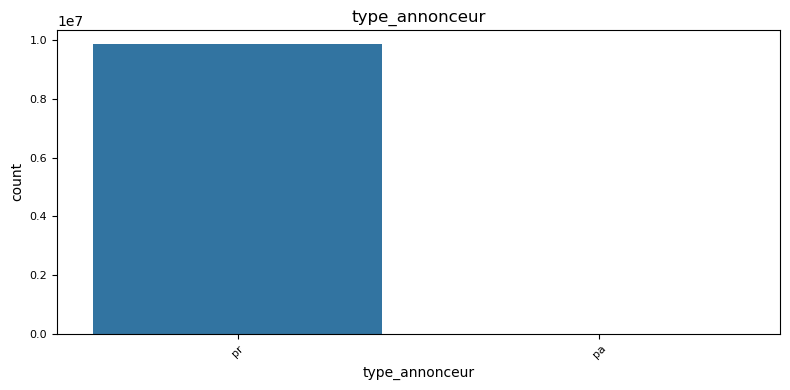

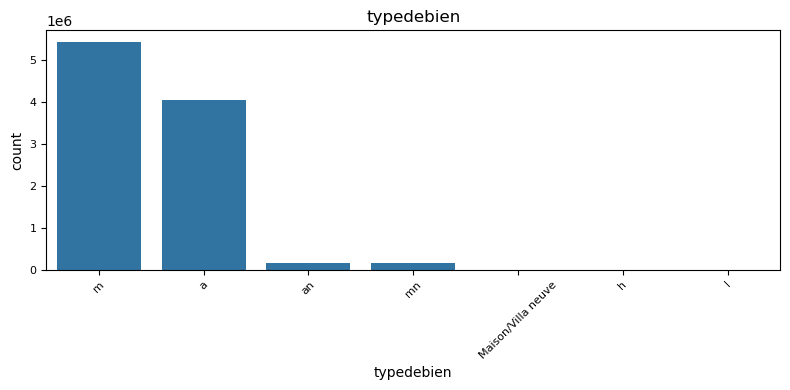

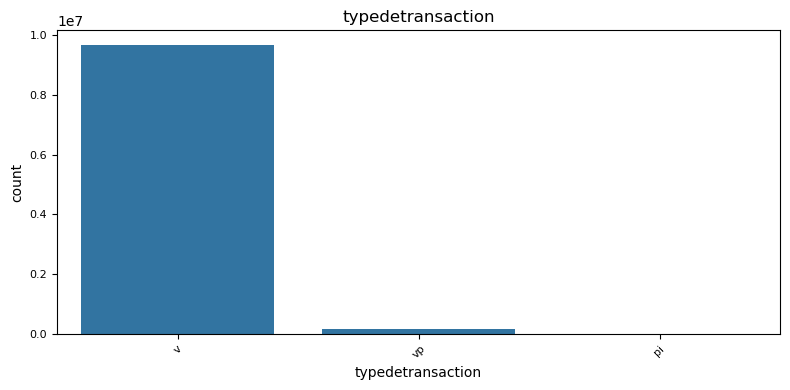

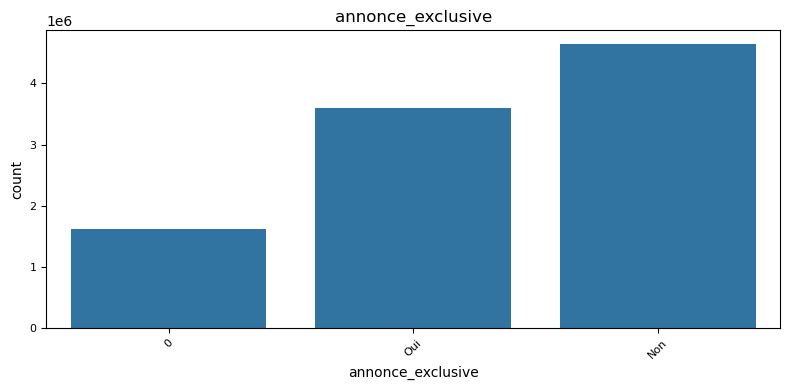

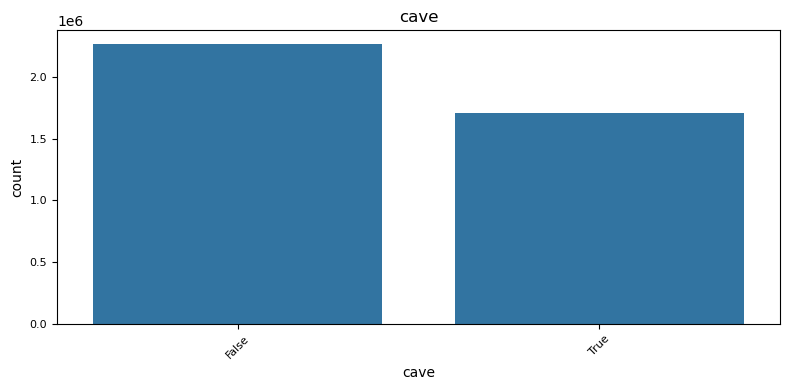

...

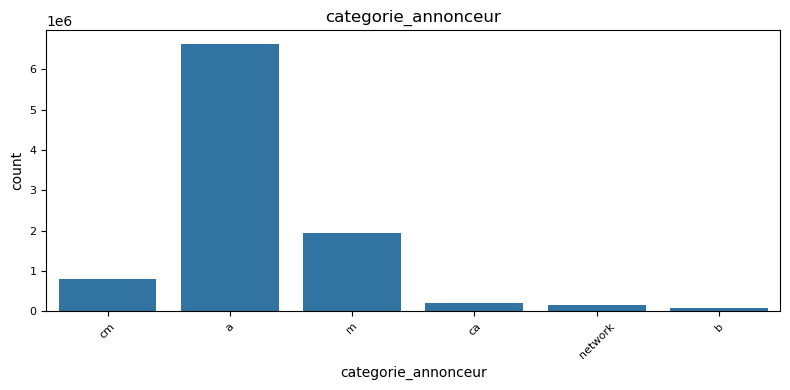

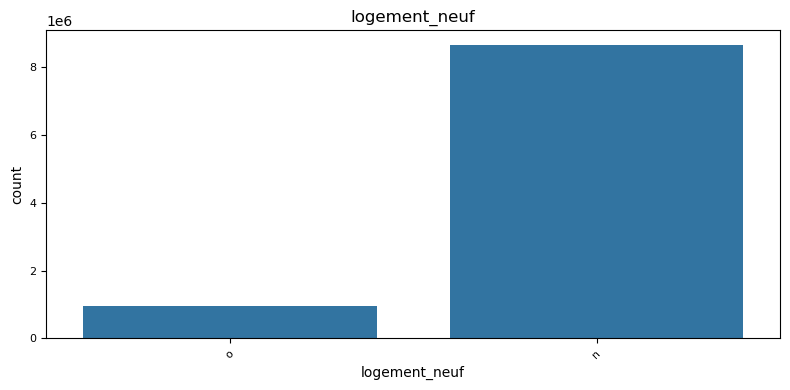

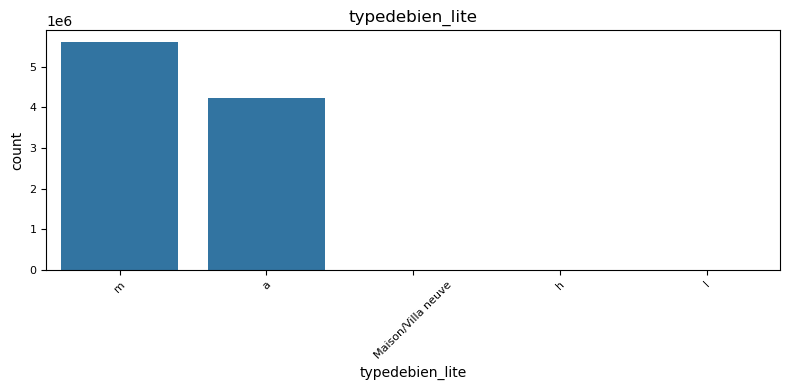

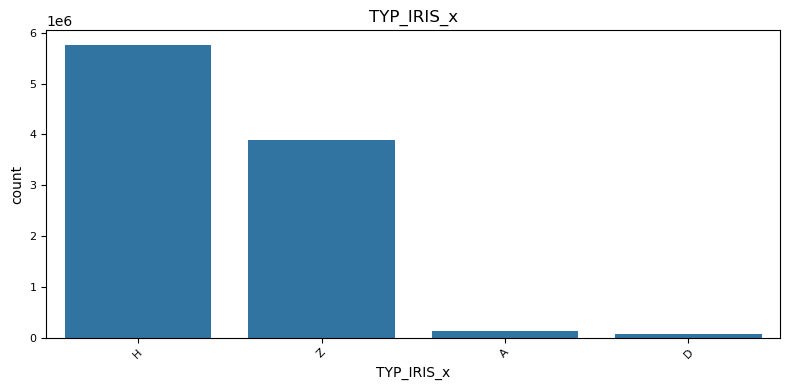

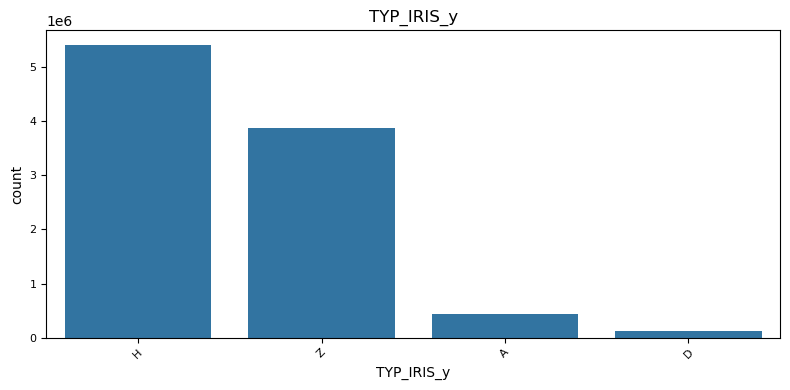

In [10]:
for var_to_viz in columns_checked:
    plt.figure(figsize=(8, 4))
    sns.countplot(data=df_sales, x=var_to_viz)
    plt.title(f'{var_to_viz}')
    plt.xticks(rotation=45, fontsize=8)
    plt.yticks(fontsize=8)
    plt.tight_layout()
    plt.show()

### Modalités des autres variables ( plus de 10 modalités )

In [27]:
columns_investigated = columns_checked
df_sales_remaining = df_sales.drop(columns_investigated,axis=1)

columns_to_check = df_sales_remaining.select_dtypes(include=['object']).columns
columns_checked = []

# Iterate through each column and filter unique values with less than 10, excluding NaN
for col in columns_to_check:
    unique_values = df_sales_remaining[col].dropna().unique()  # Exclude NaN values
    if len(unique_values) > 10:
        print(f"Column: {col}")
        print(f"Unique Values: {unique_values}")
        print("-" * 50)
        columns_checked.append(col)

Column: idannonce
Unique Values: ['entities-1037638-4560933' 'immo-facile-57743459'
 'entities-1037666-4560741' ... 'orpi-1-129011E1Q7IG'
 'orpi-1-129011E1W58D' 'orpi-1-129011E1L4UB']
--------------------------------------------------
Column: dpeL
Unique Values: ['0' 'D' 'G' 'A' 'C' 'E' 'NS' 'F' 'VI' 'B' 'Blank' 'B kWh/m².year' '856'
 'D kWh/m².year' 'A kWh/m².year' 'E kWh/m².year' 'C kWh/m².year'
 'Classe indeterminee' "'" '0 kWh/m².year' 'F kWh/m².year'
 'D - 231 kWh/m².year' 'D-218 kWh/m².year' '26']
--------------------------------------------------
Column: exposition
Unique Values: ['0' 'Sud-Ouest' 'Sud' 'Sud-Est' 'Sud/Est' 'Est' 'SO' 'Ouest' 'E, S'
 'Est-Ouest' 'Nord-Ouest' 'Nord-Sud' 'sud-ouest' 'sud-est'
 'Traversant-Est-Ouest' 'traversant' 'Nord' 'traversant nord-sud'
 'nord-est / sud-ouest' 'Sud-Est-Ouest' 'Nord-Est' 'OUEST' 'NE'
 'Sud/Ouest' 'NS' 'Nord Sud Est' 'SUD' 'SUD OUEST' 'Nord/Ouest'
 'Nord Sud Est Ouest' 'SUD EST' 'Nord-ouest' 'nord-ouest / sud-est'
 'EST SUD OUEST'

### Distribution des variables quantitatives

In [28]:
df_sales_remaining = df_sales_remaining.drop(columns_checked,axis=1)
df_sales_remaining.describe()

,etage,surface,surface_terrain,nb_pieces,prix_bien,mensualiteFinance,balcon,eau,bain,dpeC,...,date,IRIS,REG,loyer_m2_median_n6,nb_log_n6,taux_rendement_n6,loyer_m2_median_n7,nb_log_n7,taux_rendement_n7,prix_m2_vente
count,9.849326e+06,9.849326e+06,4.868426e+06,9.849326e+06,9.849326e+06,9.849326e+06,9.849326e+06,9.849326e+06,9.849326e+06,6.432280e+06,...,9849326,9.849326e+06,9.849326e+06,6.969703e+06,6.969703e+06,6.969703e+06,7.687401e+06,7.687401e+06,7.687401e+06,9849326.00
mean,2.696601e+00,1.045297e+02,5.664978e+04,4.321068e+00,3.478930e+05,6.045218e+01,1.421431e-01,4.495214e-01,5.524128e-01,2.126210e+02,...,2022-09-10 20:28:35.278711808,3.796434e+02,5.380602e+01,1.433714e+01,2.949795e+01,5.910651e-02,1.410632e+01,7.737721e+02,5.817144e-02,inf
min,-2.100000e+01,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,-3.000000e+00,-4.000000e+00,0.000000e+00,-2.480000e+02,...,2019-02-01 00:00:00,0.000000e+00,1.000000e+00,1.100000e-01,1.000000e+00,0.000000e+00,1.100000e-01,1.000000e+00,0.000000e+00,0.01
25%,0.000000e+00,6.300000e+01,3.680000e+02,3.000000e+00,1.700000e+05,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.430000e+02,...,2021-06-01 00:00:00,0.000000e+00,2.700000e+01,9.680000e+00,2.000000e+00,3.600000e-02,9.670000e+00,5.000000e+00,3.600000e-02,1987.71
50%,0.000000e+00,9.000000e+01,6.620000e+02,4.000000e+00,2.600000e+05,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.020000e+02,...,2022-12-01 00:00:00,1.020000e+02,5.300000e+01,1.254000e+01,9.000000e+00,4.500000e-02,1.243000e+01,3.500000e+01,4.500000e-02,2975.31
75%,1.000000e+00,1.280000e+02,1.303000e+03,5.000000e+00,3.974800e+05,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,2.680000e+02,...,2024-02-01 00:00:00,2.010000e+02,7.600000e+01,1.678000e+01,3.400000e+01,5.700000e-02,1.655000e+01,3.920000e+02,5.700000e-02,4441.56
max,1.000000e+04,2.310140e+05,1.170520e+11,2.020000e+02,2.690001e+10,1.096006e+08,2.131000e+03,2.018000e+03,1.237400e+04,7.157000e+04,...,2025-02-01 00:00:00,9.901000e+03,9.400000e+01,5.381740e+03,1.213000e+03,1.411740e+04,5.381740e+03,2.442000e+04,1.302030e+04,inf
std,4.523286e+01,1.238908e+02,7.513487e+07,2.086657e+00,1.213693e+07,4.938954e+04,1.669131e+00,2.388212e+00,9.181763e+00,1.177222e+02,...,NaN,1.059815e+03,2.959281e+01,1.655408e+01,5.645663e+01,9.372524e+00,1.737238e+01,2.499660e+03,8.789839e+00,NaN


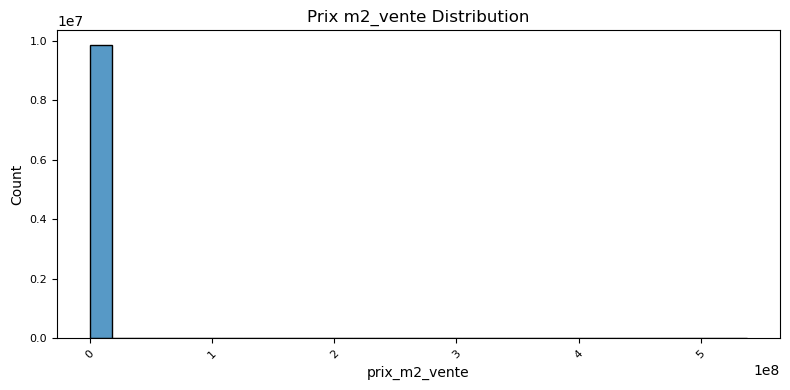

In [29]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_sales_remaining, x='prix_m2_vente', bins=30)
plt.title('Prix m2_vente Distribution')
plt.xticks(rotation=45, fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [30]:
# Calculate the IQR for 'valeur_fonciere'
Q1 = df_sales_remaining["prix_m2_vente"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_sales_remaining["prix_m2_vente"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_sales_remaining = df_sales_remaining[(df_sales_remaining["prix_m2_vente"] >= lower_bound) & (df_sales_remaining["prix_m2_vente"] <= upper_bound)]

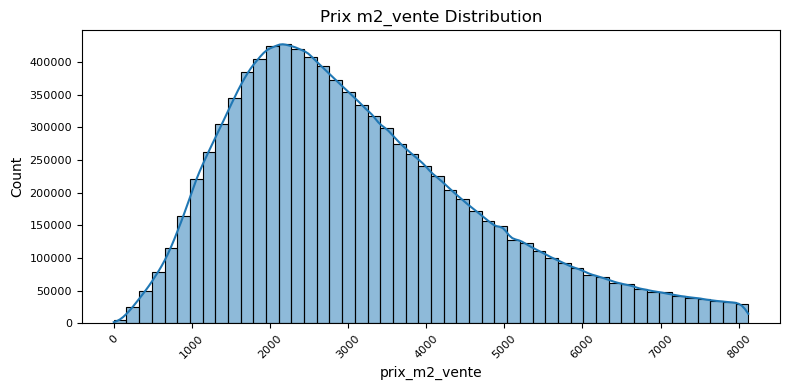

In [31]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_sales_remaining, x='prix_m2_vente', bins=50, kde=True)
plt.title('Prix m2_vente Distribution')
plt.xticks(rotation=45, fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

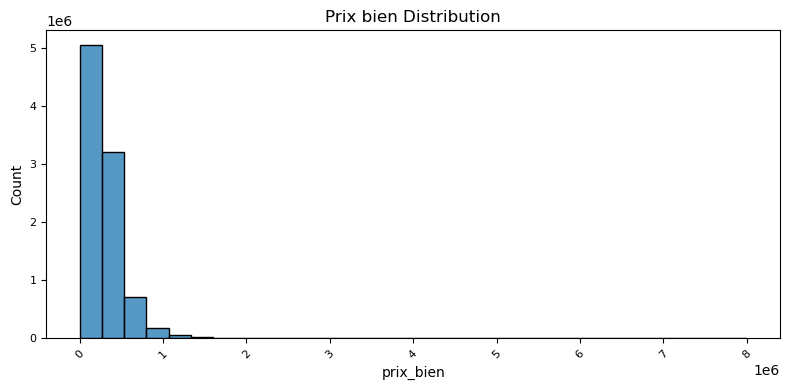

In [32]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_sales_remaining, x='prix_bien', bins=30)
plt.title('Prix bien Distribution')
plt.xticks(rotation=45, fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [33]:
# Calculate the IQR for 'valeur_fonciere'
Q1 = df_sales_remaining["prix_bien"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_sales_remaining["prix_bien"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_sales_remaining = df_sales_remaining[(df_sales_remaining["prix_bien"] >= lower_bound) & (df_sales_remaining["prix_bien"] <= upper_bound)]

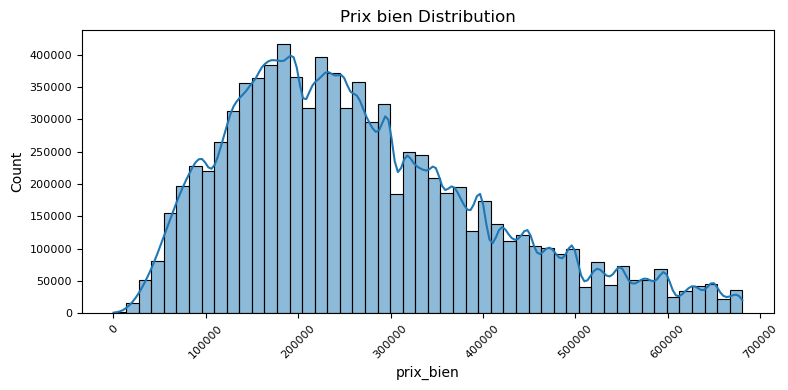

In [34]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_sales_remaining, x='prix_bien', bins=50, kde=True)
plt.title('Prix bien Distribution')
plt.xticks(rotation=45, fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

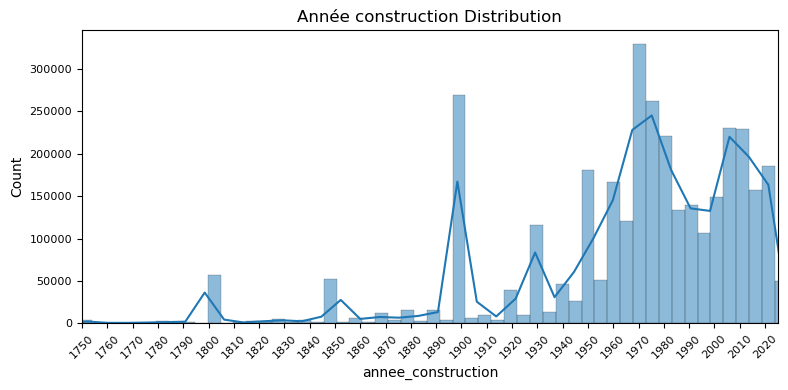

In [54]:
import numpy as np

plt.figure(figsize=(8, 4))
sns.histplot(data=df_sales_remaining, x='annee_construction', bins=300, kde=True)
plt.title('Année construction Distribution')
plt.xticks(rotation=45, fontsize=8)

tick_positions = np.arange(1750, 2026, 10)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(1750, 2025)

plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

# Lecture des données de géolocalisation

> Pour des raison de performance de plotly express, obligé d'afficher sur un échantillon de 2%.

> Au delà de cette limite, l'affichage crashe car trop de points

In [4]:
import plotly.express as px

# Calculate the IQR for 'nb_etages'
Q1 = df_sales["prix_bien"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_sales["prix_bien"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals = df_sales[(df_sales["prix_bien"] >= lower_bound) & (df_sales["prix_bien"] <= upper_bound)]

# Reduce dataset size by sampling (e.g., 10% of the data)
df_sampled = df_sales.sample(frac=0.02, random_state=42)

fig = px.scatter_map(df_sampled, lat="mapCoordonneesLatitude", lon="mapCoordonneesLongitude", color="prix_bien", height=600, width=800,
                    hover_name="typedebien", hover_data="typedebien", size="prix_bien", size_max=15, zoom=10)
fig.update_geos(projection_type="natural earth")
fig.update_layout(title="Scatter Map Prices", title_x=0.5, title_y=0.95)
fig.show()

# Exploration du fichier des locations consolidé

## Infos sur le fichier

In [4]:
folder_path = '../data/raw/Rentals'
output_file = os.path.join(folder_path, 'merged_rentals_data.csv')

df_rentals = pd.read_csv(output_file, sep=';', low_memory=False)

df_rentals.describe()

,etage,surface,surface_terrain,nb_pieces,prix_bien,prix_maison,prix_terrain,mensualiteFinance,balcon,eau,...,places_parking,annee_construction,nb_toilettes,nb_terraces,surface_balcon,nb_logements_copro,charges_copro,duree_int,IRIS,REG
count,3.464441e+06,3.464441e+06,195508.000000,3.464441e+06,3.464441e+06,0.0,0.0,3.464441e+06,3.464441e+06,3.464441e+06,...,1.312475e+06,825779.000000,1.325757e+06,813160.000000,72153.000000,7527.000000,0.0,3.422483e+06,3.464441e+06,3.464441e+06
mean,2.176918e+00,5.584622e+01,581.984442,2.516393e+00,8.457460e+02,NaN,NaN,8.578585e-04,1.949882e-01,3.739940e-01,...,4.564763e+00,1975.095036,1.134878e+00,0.437326,6.683894,61.723130,NaN,-1.608188e+02,7.074354e+02,5.179470e+01
std,3.077090e+01,3.099926e+01,2352.598052,1.215340e+00,2.075094e+03,NaN,NaN,6.009996e-01,2.056746e+00,6.185114e-01,...,1.734334e+03,49.197634,1.513575e+01,3.410736,15.259622,505.510318,NaN,3.813807e+02,1.396266e+03,3.081748e+01
min,-4.500000e+01,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,NaN,NaN,0.000000e+00,-1.000000e+00,-1.000000e+00,...,0.000000e+00,700.000000,0.000000e+00,0.000000,0.000000,0.000000,NaN,-1.125000e+03,0.000000e+00,1.000000e+00
25%,0.000000e+00,3.500000e+01,100.000000,2.000000e+00,5.310000e+02,NaN,NaN,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,1950.000000,1.000000e+00,0.000000,3.000000,0.000000,NaN,1.000000e+00,1.020000e+02,2.400000e+01
50%,1.000000e+00,5.000000e+01,312.000000,2.000000e+00,6.950000e+02,NaN,NaN,0.000000e+00,0.000000e+00,0.000000e+00,...,1.000000e+00,1987.000000,1.000000e+00,0.000000,6.000000,12.000000,NaN,1.200000e+01,1.110000e+02,5.200000e+01
75%,2.000000e+00,6.900000e+01,682.000000,3.000000e+00,9.190000e+02,NaN,NaN,0.000000e+00,0.000000e+00,1.000000e+00,...,1.000000e+00,2011.000000,1.000000e+00,1.000000,8.000000,42.000000,NaN,2.900000e+01,6.010000e+02,7.600000e+01
max,1.748700e+04,1.000000e+03,500000.000000,7.100000e+01,1.297000e+06,NaN,NaN,7.510000e+02,2.134000e+03,2.950000e+02,...,9.772990e+05,2027.000000,1.196000e+04,1695.000000,2075.000000,19464.000000,NaN,9.560000e+02,9.901000e+03,9.400000e+01


## Valeurs manquantes :

In [5]:
missing_data_percentage_rentals = df_rentals.isna().sum()*100/len(df_rentals)

missing_value_percentage_rentals = pd.DataFrame({'column_name': df_rentals.columns,
                                         'percent_missing': missing_data_percentage_rentals,
                                         'dtypes':df_rentals.dtypes}
                                         ).sort_values(by='percent_missing', ascending=False)

# Resetting the index to start from 1 for better readability
# and to match the original DataFrame's index
missing_value_percentage_rentals.index = range(1, len(missing_value_percentage_rentals) + 1)

display(missing_value_percentage_rentals)

,column_name,percent_missing,dtypes
1,prix_maison,100.000000,float64
2,charges_copro,100.000000,float64
3,prix_terrain,100.000000,float64
4,parking,99.979679,object
5,nb_logements_copro,99.782736,float64
6,videophone,98.648065,object
7,surface_balcon,97.917326,float64
8,surface_terrain,94.356723,float64
9,nb_terraces,76.528392,float64
10,annee_construction,76.164149,float64


# Visualisation des NAN

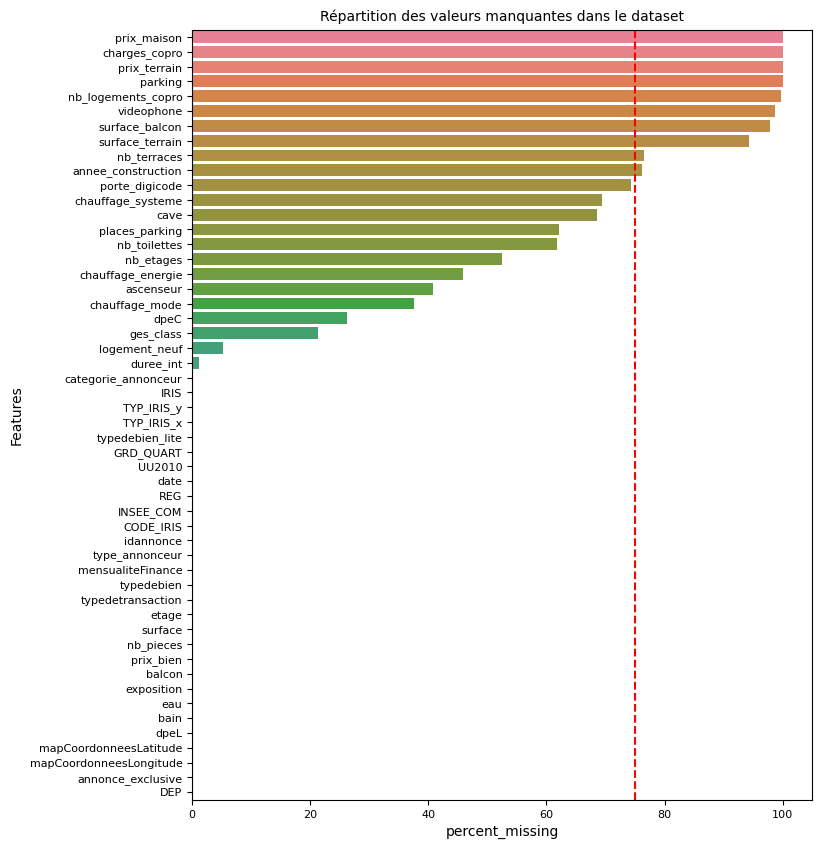

In [6]:
plt.figure(figsize=(8, 10)) 

sns.barplot(y = missing_value_percentage_rentals.column_name, 
            x = missing_value_percentage_rentals.percent_missing, 
            hue = missing_value_percentage_rentals.column_name, 
            order = missing_value_percentage_rentals.column_name)

# Add a vertical line at x=50 (adjust as needed)
plt.axvline(x=75, color='red', linestyle='--', label='Threshold (75%)')

plt.title('Répartition des valeurs manquantes dans le dataset', fontsize=10)

plt.xticks(fontsize=8)  
plt.yticks(fontsize=8)  
plt.ylabel('Features');

### Nom des variables dont le pourcentage de valeurs manquantes est inférieur à 75 %

> Dans notre dataset, on constate que la grande diversité des variables. Cette grande diversité nous permet de faire le choix d'éliminer certaines variables qui représentent peu d'enjeux dans la prédiction de notre modèle, par exemple la surface du balcon. D'autres variables sont redondants quant ils sont renseignés car on connait le prix total du bien de toute manière. Arbitrairement, le seuil de valeurs manquantes que nous choisirons sera de 75 % de valeurs manquantes dans la variable.

In [8]:
missing_values = df_rentals.isnull().mean()

variables_to_keep = missing_values[missing_values <= 0.75].index
print(variables_to_keep)

Index(['idannonce', 'type_annonceur', 'typedebien', 'typedetransaction',
       'etage', 'surface', 'nb_pieces', 'prix_bien', 'mensualiteFinance',
       'balcon', 'eau', 'bain', 'dpeL', 'dpeC', 'mapCoordonneesLatitude',
       'mapCoordonneesLongitude', 'annonce_exclusive', 'nb_etages',
       'places_parking', 'cave', 'exposition', 'ges_class', 'nb_toilettes',
       'porte_digicode', 'ascenseur', 'chauffage_energie', 'chauffage_systeme',
       'chauffage_mode', 'categorie_annonceur', 'logement_neuf', 'duree_int',
       'typedebien_lite', 'date', 'INSEE_COM', 'IRIS', 'CODE_IRIS',
       'TYP_IRIS_x', 'TYP_IRIS_y', 'GRD_QUART', 'UU2010', 'REG', 'DEP'],
      dtype='object')


### Mise à jour du dataset avec seulement les variables à garder.

In [9]:
df_rentals["date"] = pd.to_datetime(df_rentals["date"], format='%Y-%m')
df_rentals = df_rentals[variables_to_keep]
df_rentals.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3464441 entries, 0 to 3464440
Data columns (total 42 columns):
 #   Column                   Non-Null Count    Dtype         
---  ------                   --------------    -----         
 0   idannonce                3464441 non-null  object        
 1   type_annonceur           3464441 non-null  object        
 2   typedebien               3464441 non-null  object        
 3   typedetransaction        3464441 non-null  object        
 4   etage                    3464441 non-null  int64         
 5   surface                  3464441 non-null  int64         
 6   nb_pieces                3464441 non-null  int64         
 7   prix_bien                3464441 non-null  int64         
 8   mensualiteFinance        3464441 non-null  int64         
 9   balcon                   3464441 non-null  int64         
 10  eau                      3464441 non-null  int64         
 11  bain                     3464441 non-null  int64         
 12  

# Dataviz

### Modalités des variables catégorielles ( moins de 10 modalités )

In [11]:
# Combine object and numerical columns
columns_to_check = df_rentals.select_dtypes(include=['object', 'int64', 'float64']).columns

columns_checked = []

# Iterate through each column and filter unique values with less than 10, excluding NaN
for col in columns_to_check:
    unique_values = df_rentals[col].dropna().unique()  # Exclude NaN values
    if len(unique_values) < 10:
        print(f"Column: {col}")
        print(f"Unique Values: {unique_values}")
        print("-" * 50)
        columns_checked.append(col)


Column: type_annonceur
Unique Values: ['pr' 'pa']
--------------------------------------------------
Column: typedebien
Unique Values: ['m' 'a' 'l' 'd' 'h']
--------------------------------------------------
Column: typedetransaction
Unique Values: ['l' 'lt']
--------------------------------------------------
Column: mensualiteFinance
Unique Values: [  0 112  91  70 751  78  83]
--------------------------------------------------
Column: annonce_exclusive
Unique Values: ['0' 'Non' 'Oui']
--------------------------------------------------
Column: cave
Unique Values: [False True]
--------------------------------------------------
Column: porte_digicode
Unique Values: [False True]
--------------------------------------------------
Column: ascenseur
Unique Values: [False True]
--------------------------------------------------
Column: chauffage_mode
Unique Values: ['Individuel' 'Collectif' 'Central' 'Individuel, Central'
 'Collectif, Individuel' 'Collectif, Central'
 'Collectif, Individuel,

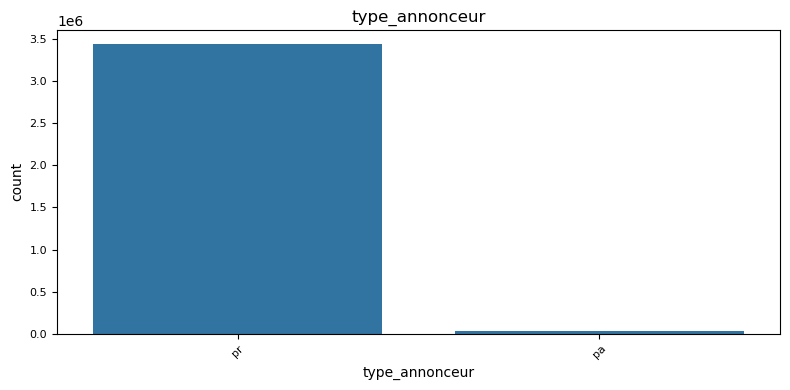

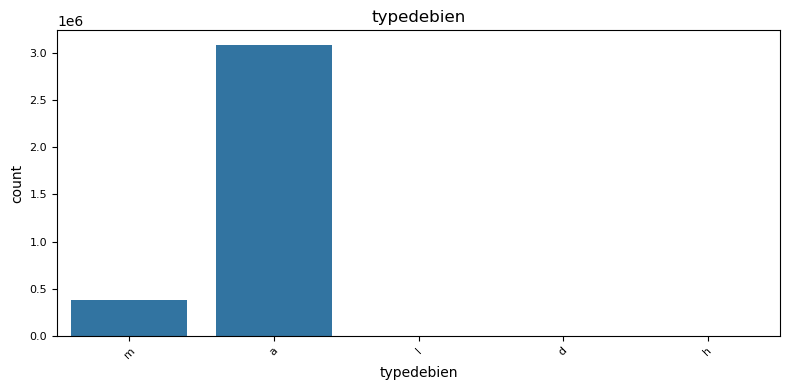

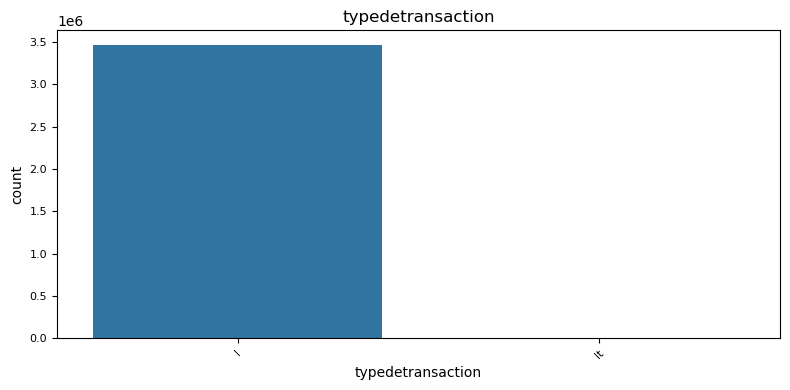

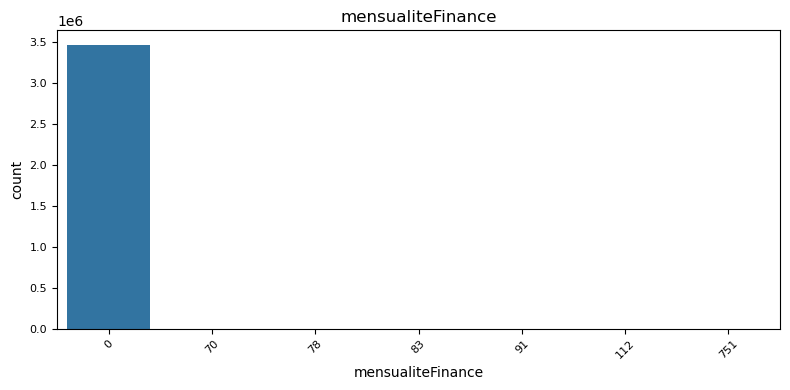

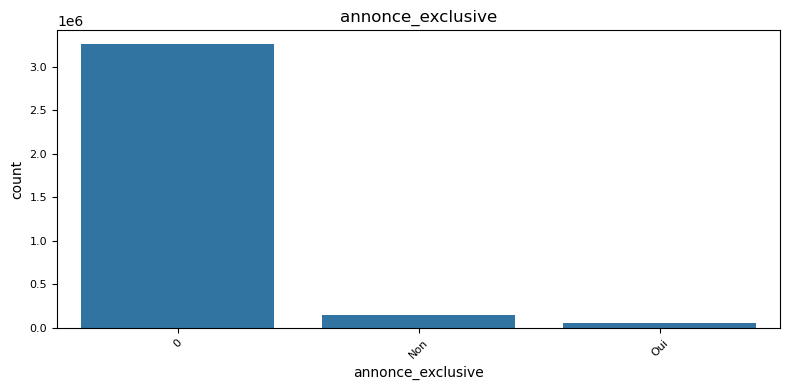

...

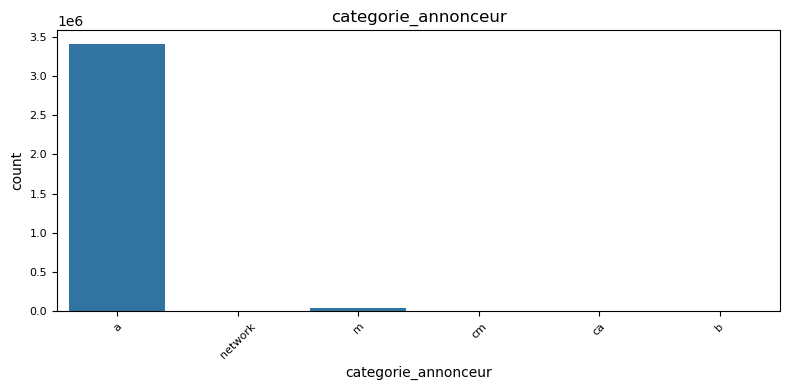

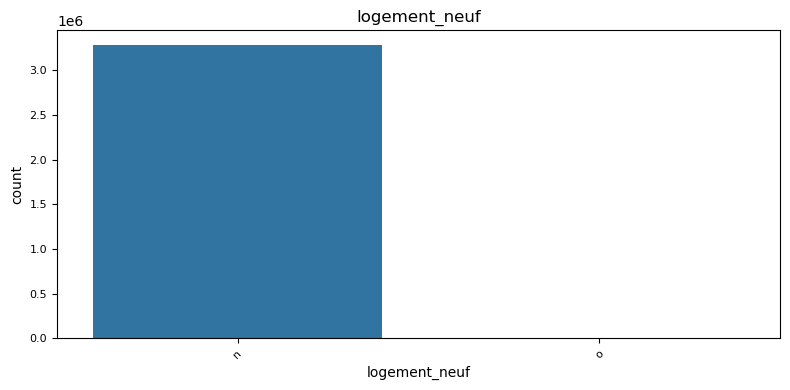

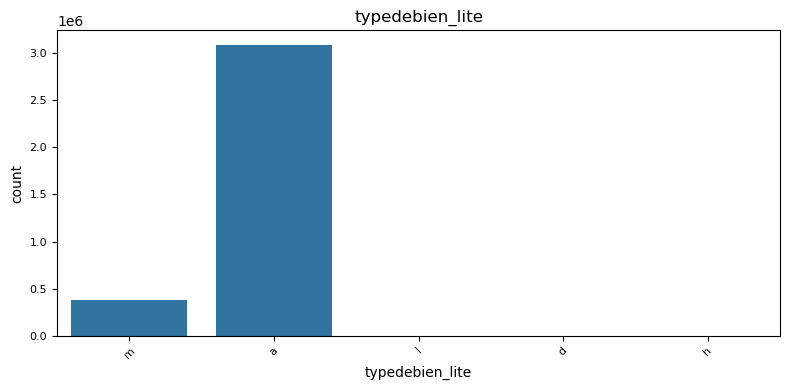

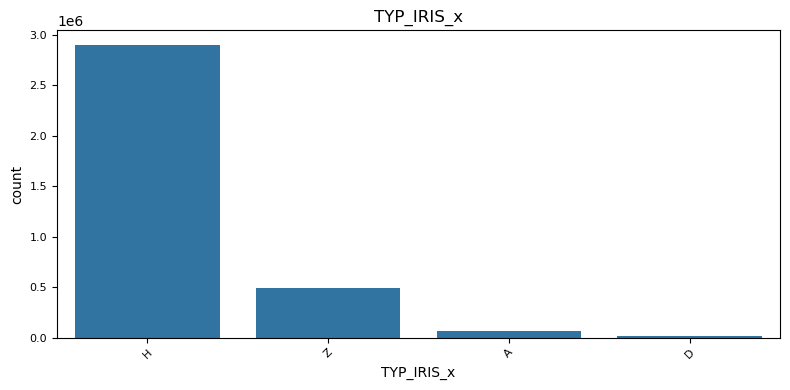

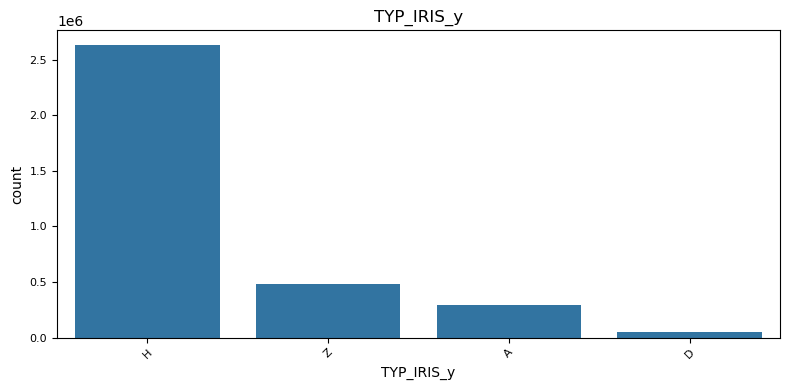

In [13]:
for var_to_viz in columns_checked:
    plt.figure(figsize=(8, 4))
    sns.countplot(data=df_rentals, x=var_to_viz)
    plt.title(f'{var_to_viz}')
    plt.xticks(rotation=45, fontsize=8)
    plt.yticks(fontsize=8)
    plt.tight_layout()
    plt.show()

### Modalités des autres variables ( plus de 10 modalités )

In [14]:
columns_investigated = columns_checked
df_rentals_remaining = df_rentals.drop(columns_investigated,axis=1)

columns_to_check = df_rentals_remaining.select_dtypes(include=['object']).columns
columns_checked = []

# Iterate through each column and filter unique values with less than 10, excluding NaN
for col in columns_to_check:
    unique_values = df_rentals_remaining[col].dropna().unique()  # Exclude NaN values
    if len(unique_values) > 10:
        print(f"Column: {col}")
        print(f"Unique Values: {unique_values}")
        print("-" * 50)
        columns_checked.append(col)

Column: idannonce
Unique Values: ['immo-facile-57743658' 'immo-facile-57912752' 'hektor-proertygeneva-663'
 ... 'orpi-1-129011E24R9I' 'orpi-1-129011E24HB5' 'orpi-1-129011E232I2']
--------------------------------------------------
Column: dpeL
Unique Values: ['D' 'VI' 'E' 'C' 'A' 'G' 'B' '0' 'NS' 'F' 'Blank' 'D kWh/m².year'
 'A kWh/m².year' '37' 'E kWh/m².year' 'B kWh/m².year']
--------------------------------------------------
Column: exposition
Unique Values: ['0' 'Sud' 'Nord-Ouest' 'Sud-Ouest' 'Est' 'Ouest' 'Nord-Sud' 'Est-Ouest'
 'Sud-Est' 'Nord-ouest' 'E-O' 'Nord' 'Nord-Est' 'sud-est' 'E-S-O' 'OUEST'
 'nord-ouest / sud-est' 'est sud ouest' 'Nord-est' 'SUD OUEST' 'sud-ouest'
 'SO' 'Nord Est Ouest' 'Nord Sud Est Ouest' 'Nord Sud Ouest' 'traversant'
 'Sud-Est-Ouest' 'est ouest' 'SUD/OUEST' 'EST/OUEST' 'NORD' 'EST'
 'Nord Sud Est' 'SUD' 'Traversant-Est-Ouest' 'SUD EST' 'Sud Nord'
 'SUD/EST/OUEST' 'sud nord' 'Sud / ouest' 'Sud Nord Est Ouest' 'sud/ast'
 'Est / Ouest' 'Sud Est Nord Ouest

### Distribution des variables quantitatives

In [16]:
df_rentals_remaining = df_rentals_remaining.drop(columns_checked,axis=1)
df_rentals_remaining.describe()

,etage,surface,nb_pieces,prix_bien,balcon,eau,bain,dpeC,mapCoordonneesLatitude,mapCoordonneesLongitude,nb_etages,places_parking,nb_toilettes,duree_int,date,IRIS,REG
count,3.464441e+06,3.464441e+06,3.464441e+06,3.464441e+06,3.464441e+06,3.464441e+06,3.464441e+06,2.557038e+06,3.464441e+06,3.464441e+06,1.648799e+06,1.312475e+06,1.325757e+06,3.422483e+06,3464441,3.464441e+06,3.464441e+06
mean,2.176918e+00,5.584622e+01,2.516393e+00,8.457460e+02,1.949882e-01,3.739940e-01,4.700242e-01,9.866740e+02,4.627708e+01,2.634383e+00,3.853496e+00,4.564763e+00,1.134878e+00,-1.608188e+02,2022-03-03 22:40:26.608623616,7.074354e+02,5.179470e+01
min,-4.500000e+01,1.000000e+00,1.000000e+00,1.000000e+00,-1.000000e+00,-1.000000e+00,-2.000000e+00,-7.200000e+01,-2.137770e+01,-6.180724e+01,-1.000000e+00,0.000000e+00,0.000000e+00,-1.125000e+03,2019-04-01 00:00:00,0.000000e+00,1.000000e+00
25%,0.000000e+00,3.500000e+01,2.000000e+00,5.310000e+02,0.000000e+00,0.000000e+00,0.000000e+00,1.310000e+02,4.389367e+01,1.457050e+00,2.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,2020-09-01 00:00:00,1.020000e+02,2.400000e+01
50%,1.000000e+00,5.000000e+01,2.000000e+00,6.950000e+02,0.000000e+00,0.000000e+00,0.000000e+00,2.010000e+02,4.720261e+01,2.451520e+00,3.000000e+00,1.000000e+00,1.000000e+00,1.200000e+01,2022-02-01 00:00:00,1.110000e+02,5.200000e+01
75%,2.000000e+00,6.900000e+01,3.000000e+00,9.190000e+02,0.000000e+00,1.000000e+00,1.000000e+00,2.670000e+02,4.883316e+01,4.868980e+00,5.000000e+00,1.000000e+00,1.000000e+00,2.900000e+01,2023-09-01 00:00:00,6.010000e+02,7.600000e+01
max,1.748700e+04,1.000000e+03,7.100000e+01,1.297000e+06,2.134000e+03,2.950000e+02,1.111100e+04,1.001010e+09,5.108320e+01,5.573551e+01,6.188000e+04,9.772990e+05,1.196000e+04,9.560000e+02,2025-02-01 00:00:00,9.901000e+03,9.400000e+01
std,3.077090e+01,3.099926e+01,1.215340e+00,2.075094e+03,2.056746e+00,6.185114e-01,8.958507e+00,8.852886e+05,4.667881e+00,6.089874e+00,9.123105e+01,1.734334e+03,1.513575e+01,3.813807e+02,NaN,1.396266e+03,3.081748e+01


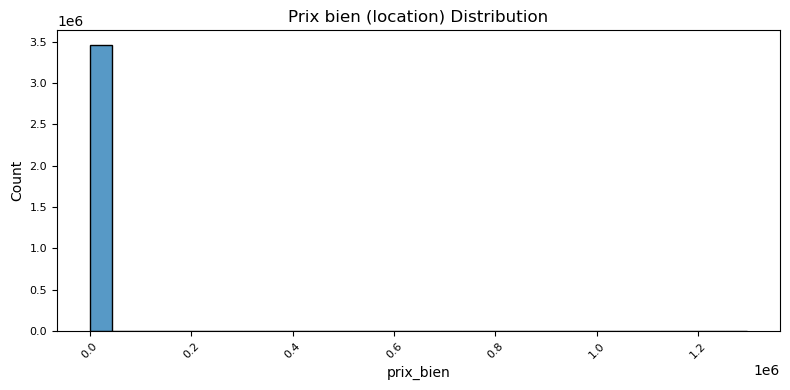

In [18]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='prix_bien', bins=30)
plt.title('Prix bien (location) Distribution')
plt.xticks(rotation=45, fontsize=8)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [22]:
# Calculate the IQR for 'valeur_fonciere'
Q1 = df_rentals_remaining["prix_bien"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_rentals_remaining["prix_bien"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals_remaining = df_rentals_remaining[(df_rentals_remaining["prix_bien"] >= lower_bound) & (df_rentals_remaining["prix_bien"] <= upper_bound)]

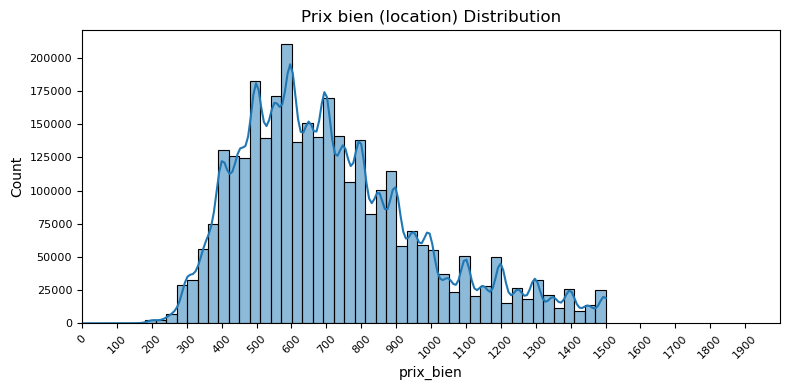

In [31]:
import numpy as np
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='prix_bien', bins=50, kde=True)
plt.title('Prix bien (location) Distribution')
tick_positions = np.arange(0, 2000, 100)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 2000)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

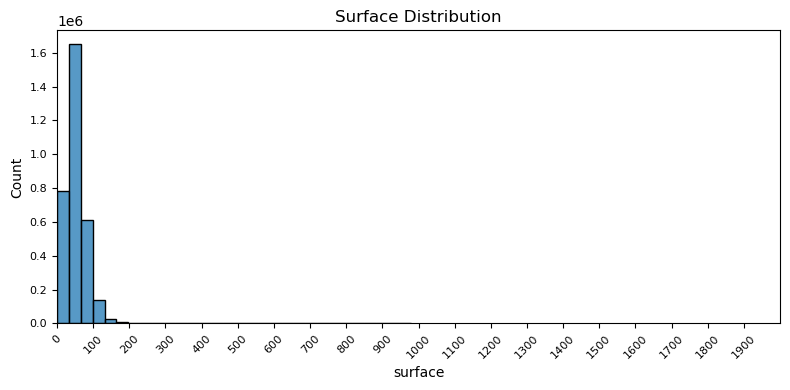

In [33]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='surface', bins=30)
plt.title('Surface Distribution')
tick_positions = np.arange(0, 2000, 100)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 2000)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [ ]:
# Calculate the IQR for 'surface'
Q1 = df_rentals_remaining["surface"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_rentals_remaining["surface"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals_remaining = df_rentals_remaining[(df_rentals_remaining["surface"] >= lower_bound) & (df_rentals_remaining["surface"] <= upper_bound)]

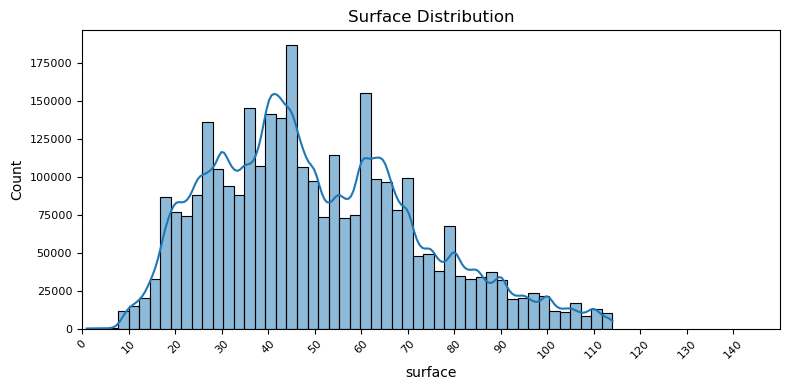

In [44]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='surface', bins=50, kde=True)
plt.title('Surface Distribution')
tick_positions = np.arange(0, 150, 10)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 150)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

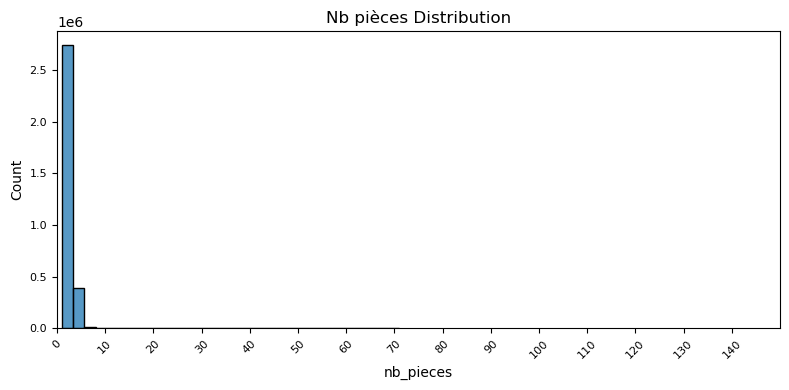

In [45]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='nb_pieces', bins=30,)
plt.title('Nb pièces Distribution')
tick_positions = np.arange(0, 150, 10)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 150)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [ ]:
# Calculate the IQR for 'nb_pieces'
Q1 = df_rentals_remaining["nb_pieces"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_rentals_remaining["nb_pieces"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals_remaining = df_rentals_remaining[(df_rentals_remaining["nb_pieces"] >= lower_bound) & (df_rentals_remaining["nb_pieces"] <= upper_bound)]

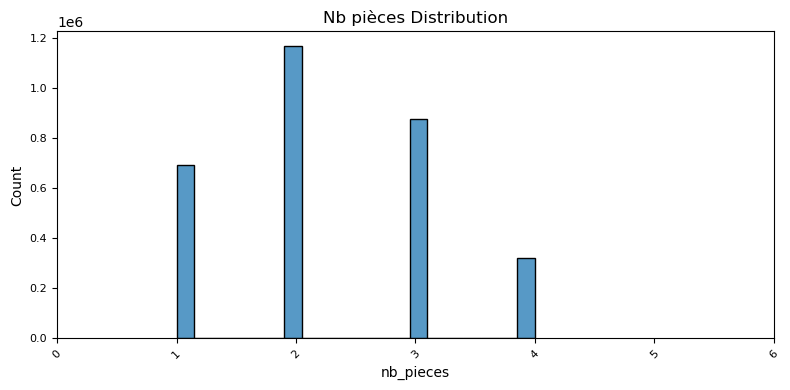

In [58]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='nb_pieces', bins=20)
plt.title('Nb pièces Distribution')
tick_positions = np.arange(0, 15, 1)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 6)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

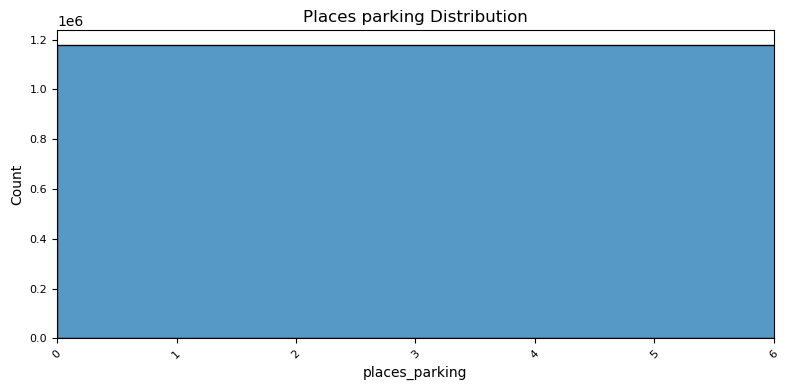

In [62]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='places_parking', bins=20)
plt.title('Places parking Distribution')
tick_positions = np.arange(0, 15, 1)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 6)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [ ]:
# Calculate the IQR for 'places_parking'
Q1 = df_rentals_remaining["places_parking"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_rentals_remaining["places_parking"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals_remaining = df_rentals_remaining[(df_rentals_remaining["places_parking"] >= lower_bound) & (df_rentals_remaining["places_parking"] <= upper_bound)]

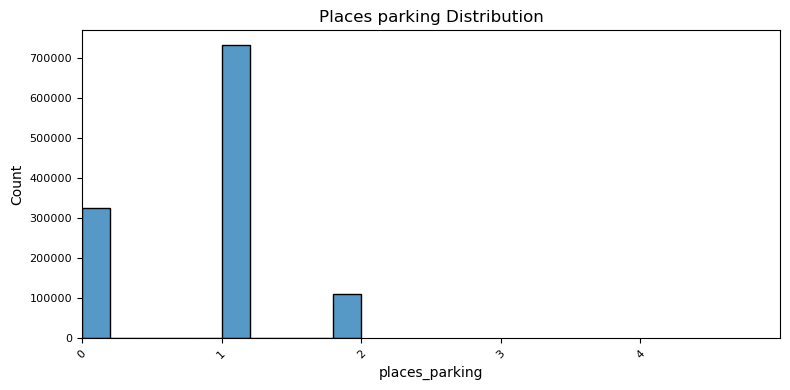

In [66]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='places_parking', bins=10)
plt.title('Places parking Distribution')
tick_positions = np.arange(0, 5, 1)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 5)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

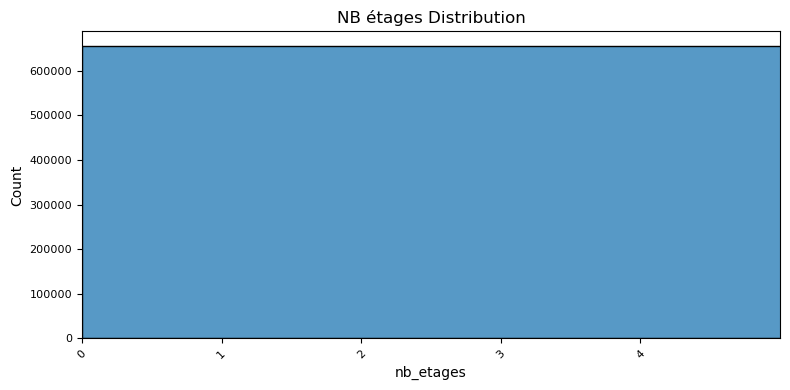

In [67]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='nb_etages', bins=10)
plt.title('NB étages Distribution')
tick_positions = np.arange(0, 5, 1)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 5)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

> Il est problable qu'il y ait eu un problème de collectecte et la présence d'outliners

In [ ]:
# Calculate the IQR for 'nb_etages'
Q1 = df_rentals_remaining["nb_etages"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_rentals_remaining["nb_etages"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals_remaining = df_rentals_remaining[(df_rentals_remaining["nb_etages"] >= lower_bound) & (df_rentals_remaining["nb_etages"] <= upper_bound)]

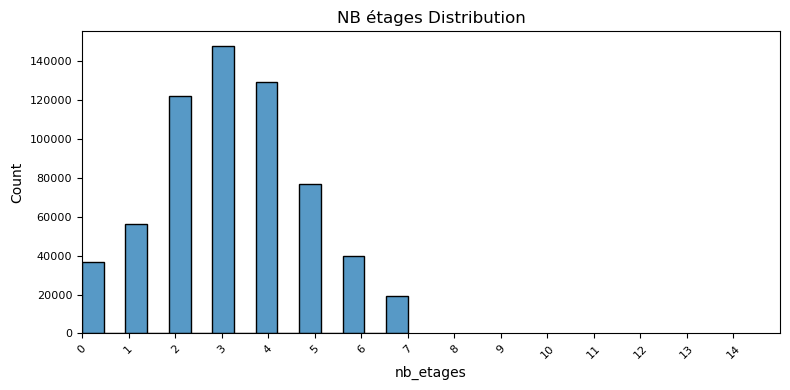

In [71]:
plt.figure(figsize=(8, 4))
sns.histplot(data=df_rentals_remaining, x='nb_etages', bins=15)
plt.title('NB étages Distribution')
tick_positions = np.arange(0, 15, 1)
plt.xticks(tick_positions, rotation=45, fontsize=8)
plt.xlim(0, 15)
plt.yticks(fontsize=8)
plt.tight_layout()
plt.show()

# Lecture des données de géolocalisation

> Pour des raison de performance de plotly express, obligé d'afficher sur un échantillon de 2%.

> Au delà de cette limite, l'affichage crashe car trop de points

In [76]:
import plotly.express as px

# Calculate the IQR for 'nb_etages'
Q1 = df_rentals["prix_bien"].quantile(0.25)  # First quartile (25th percentile)
Q3 = df_rentals["prix_bien"].quantile(0.75)  # Third quartile (75th percentile)
IQR = Q3 - Q1  # Interquartile range

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the DataFrame to remove outliers
df_rentals = df_rentals[(df_rentals["prix_bien"] >= lower_bound) & (df_rentals["prix_bien"] <= upper_bound)]

# Reduce dataset size by sampling (e.g., 10% of the data)
df_sampled = df_rentals.sample(frac=0.02, random_state=42)

fig = px.scatter_map(df_sampled, lat="mapCoordonneesLatitude", lon="mapCoordonneesLongitude", color="prix_bien", height=600, width=800,
                    hover_name="typedebien", hover_data="typedebien", size="prix_bien", size_max=15, zoom=10)
fig.update_geos(projection_type="natural earth")
fig.update_layout(title="Scatter Map Locations", title_x=0.5, title_y=0.95)
fig.show()